In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/subpopulations/Myeloid/scvi_latent20"
)
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Myeloid.h5ad")
)

In [5]:
adata

AnnData object with n_obs × n_vars = 19398 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 'cell_source', 'Annotation_scVI', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Cell_subtype_colors', 'Cell_type_colors', 'Therapy_colors', 'Tissue_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_source_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    varm: 'PCs'
    layers: 'log1p', 'normalised', 'raw', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [6]:
adata.obs.cell_source.value_counts()

Wu-Cells      9215
Che-Cells     8272
BCI-Nuclei    1911
Name: cell_source, dtype: int64

In [7]:
adata.obs.Patient.value_counts()

Wu2021_P14    3453
COL15         3101
COL07         1633
Wu2021_P13    1596
COL17         1358
COL18         1184
Wu2021_P18    1034
COL16          816
Wu2021_P20     488
Wu2021_P15     468
CRC08          446
Wu2021_P19     386
Wu2021_P17     384
Wu2021_P10     320
Wu2021_P16     257
CRC12          246
Wu2021_P3      242
CRC15          222
CRC10          207
Wu2021_P2      191
COL12          180
Wu2021_P12     171
CRC03          161
CRC04          147
CRC09          107
CRC11           91
Wu2021_P6       78
Wu2021_P8       76
CRC06           73
CRC14           55
CRC13           53
CRC02           51
Wu2021_P1       41
CRC05           22
CRC07           19
CRC01           11
Wu2021_P11       8
Wu2021_P4        7
Wu2021_P7        7
Wu2021_P9        5
Wu2021_P5        3
Name: Patient, dtype: int64

### Leiden clustering

In [8]:
adata.uns["neighbors"]

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 15, 'n_pcs': 20, 'random_state': 7, 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [9]:
from collections import Counter


def clustering_leiden_resolution(adata2test, res_range):
    """
    Performs hyperparameter search for resolution in leiden clustering
    :param adata2test: AnnData frame
    :param res_range: range of values to evaluate: i.e. np.arange(0.1, 1.5, 0.05)
    """
    resolution_dict = {r: None for r in res_range}
    # vary resolution parameter and see which nb of clusters occurs more frequently
    for r in res_range:
        # load adata
        adata = adata2test.copy()
        sc.tl.leiden(adata, resolution=r, random_state=7)
        # store nb of clusters for that resolution
        resolution_dict[r] = len(set(adata.obs["leiden"]))

    # plot figure: nb clusters in fct of resolution param
    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI, figsize=(5, 4.5)
    )
    plt.scatter(resolution_dict.keys(), resolution_dict.values())
    ax.set_xlabel("Resolution")
    ax.set_ylabel("Number of clusters")
    ax.tick_params(axis="both", which="major", labelsize=FONTSIZE - 10)
    plt.show()

    # display nb of times each number of clusters occurs
    print("Frequency of NB clusters")
    print(Counter(list(resolution_dict.values())))

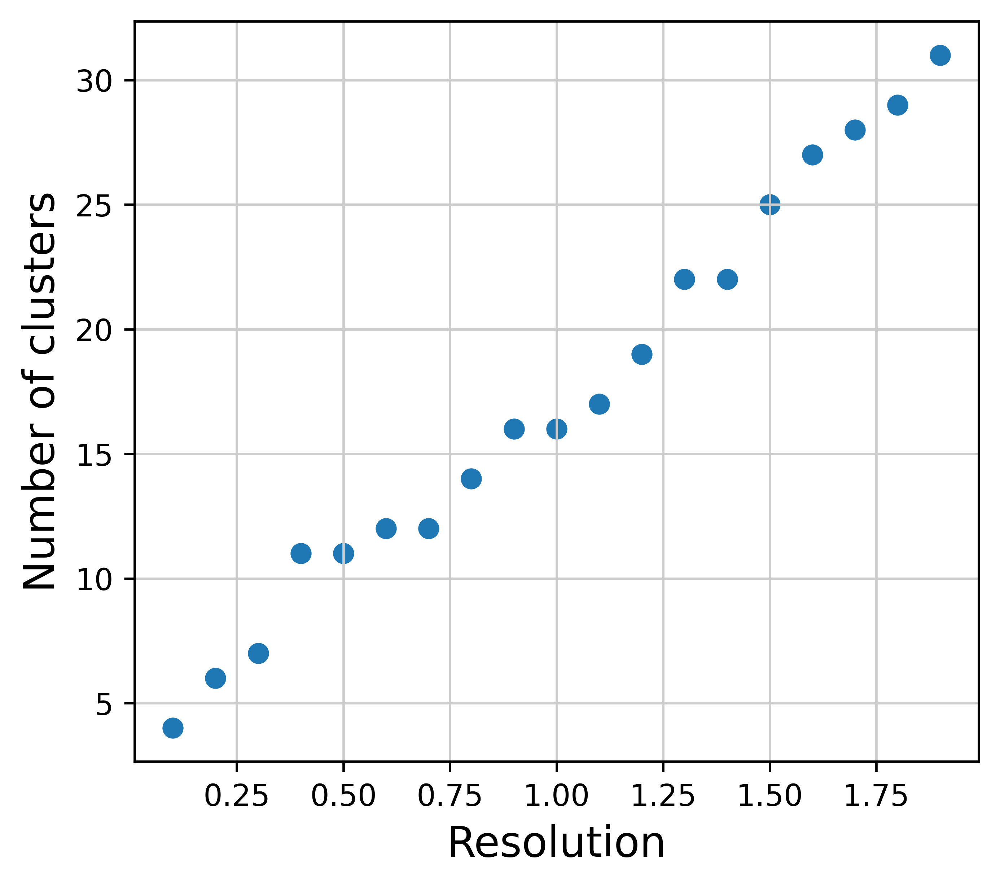

Frequency of NB clusters
Counter({11: 2, 12: 2, 16: 2, 22: 2, 4: 1, 6: 1, 7: 1, 14: 1, 17: 1, 19: 1, 25: 1, 27: 1, 28: 1, 29: 1, 31: 1})


In [10]:
clustering_leiden_resolution(adata, res_range=np.arange(0.1, 2, 0.1))

In [13]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI", resolution=1.4, random_state=7)

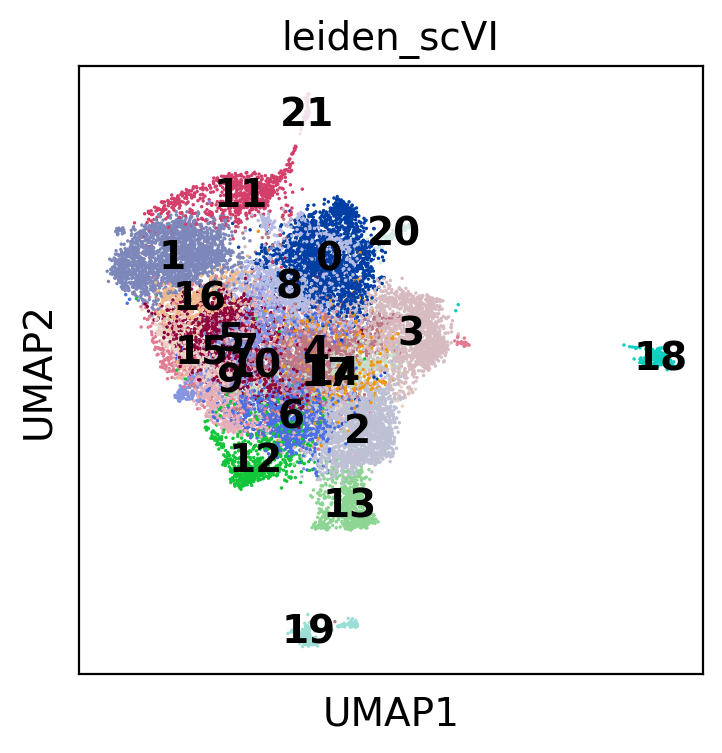

In [14]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    legend_loc="on data",
    save="general_clustering.pdf",
    show=True,
)

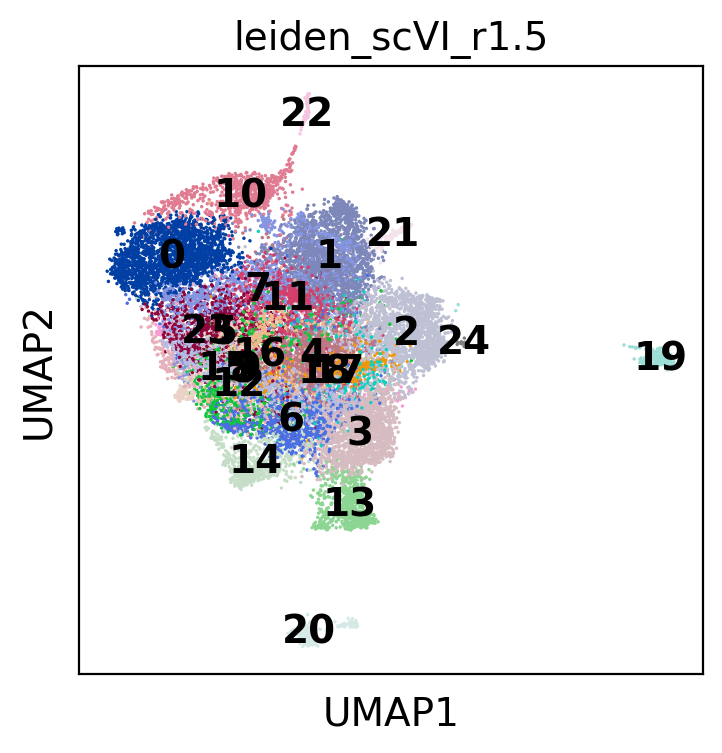

In [15]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI_r1.5", resolution=1.5, random_state=7)
sc.pl.umap(adata, color="leiden_scVI_r1.5", legend_loc="on data", show=True)

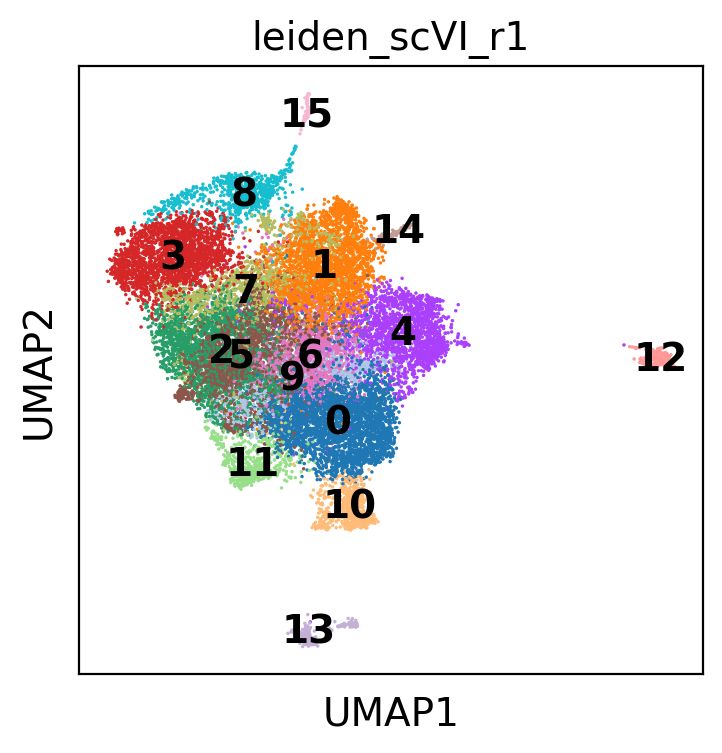

In [16]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI_r1", resolution=1, random_state=7)
sc.pl.umap(adata, color="leiden_scVI_r1", legend_loc="on data", show=True)

In [17]:
adata.obs.leiden_scVI.value_counts()

0     2075
1     2038
2     1739
3     1541
4     1434
5     1402
6     1055
7     1012
8      999
9      912
10     786
11     776
12     617
13     600
14     513
15     507
16     387
17     342
18     241
19     235
20     109
21      78
Name: leiden_scVI, dtype: int64

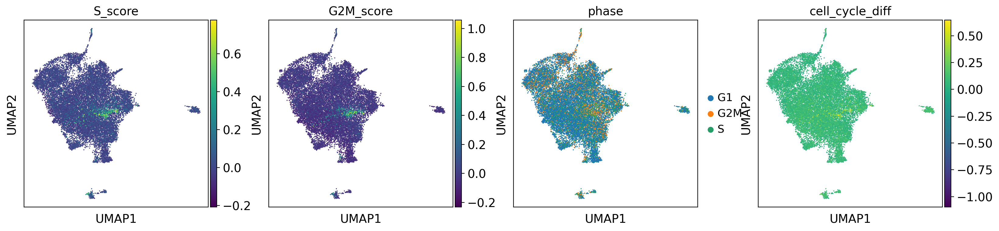

In [18]:
sc.pl.umap(
    adata,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

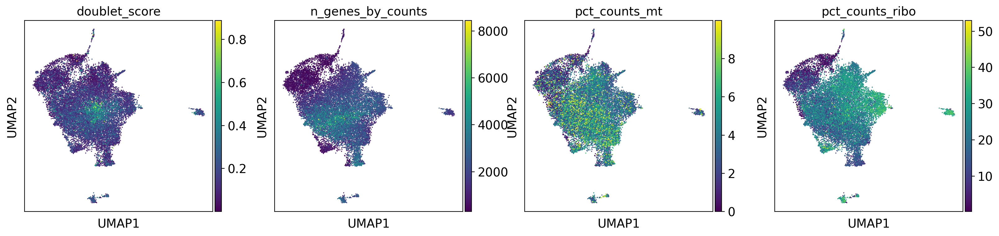

In [19]:
sc.pl.umap(
    adata,
    color=[
        "doublet_score",
        "n_genes_by_counts",
        "pct_counts_mt",
        "pct_counts_ribo",
    ],
    color_map="viridis",
    save="QC_covariates.pdf",
)

In [20]:
adata.obs.groupby("cell_source").size()

cell_source
BCI-Nuclei    1911
Che-Cells     8272
Wu-Cells      9215
dtype: int64

In [21]:
adata.obs[adata.obs["doublet_score"] > 0.4].groupby("cell_source").size()

cell_source
BCI-Nuclei     34
Che-Cells     274
Wu-Cells       86
dtype: int64

### Look at distribution of cell source across clusters 

### Plot some markers 

In [22]:
markers_myeloid_general = {
    "Macrophage": ["APOC1", "C1QC", "APOE", "FCER1G", "CD163"],
    "Monocyte": ["S100A8", "S100A9", "VCAN", "FCN1"],
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A"],
    "Neutrophil": ["FCGR3B", "S100A8", "S100A12"],
    "Cycling": ["MKI67"],
}

markers_macrophage = {
    "Macrophage": ["APOC1", "C1QC", "APOE", "FCER1G", "CD163"],
    "MHCII": [
        "HLA-DRA",
        "HLA-DRB1",
        "HLA-DRB5",
        "HLA-A",
        "HLA-C",
        "HLA-DQA1",
        "HLA-DQB1",
        "HLA-DPA1",
    ],
    "PLTP LYVE1": ["PLTP", "LYVE1"],
    "SPP1": ["SPP1", "VEGFA", "MARCO", "FN1", "SLC11A1", "IL1RN"],
    "C1QC": ["C1QC", "FPR3", "TREM2", "MS4A4A", "SLAMF8", "FCGR1A"],
    "NLRP3/IL1B": ["NLRP3", "EREG", "IL1B", "CCL3"],
    "Kupffer": ["CETP", "CD5L", "TIMD4"],
}

markers_monocyte = {
    "Monocyte": ["S100A8", "S100A9", "VCAN", "FCN1"],
    "CD14": ["CD14"],
    "CD16": ["FCGR3A"],
    "FCN1": ["FCN1"],
}

DC_markers = {
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A"],
    "cDC1": ["CLEC9A", "XCR1", "BATF3", "RAB7B", "CADM1"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A", "MSLN", "JAML"],
    "DC3": ["CLEC10A", "S100A8", "CD36", "CD163"],
    "pDC": ["IL3RA", "LILRA4", "PLD4", "JCHAIN", "IL3RA", "SPIB", "MZB1", "IRF7"],
    "migDC": ["LAMP3", "CCR7"],
}

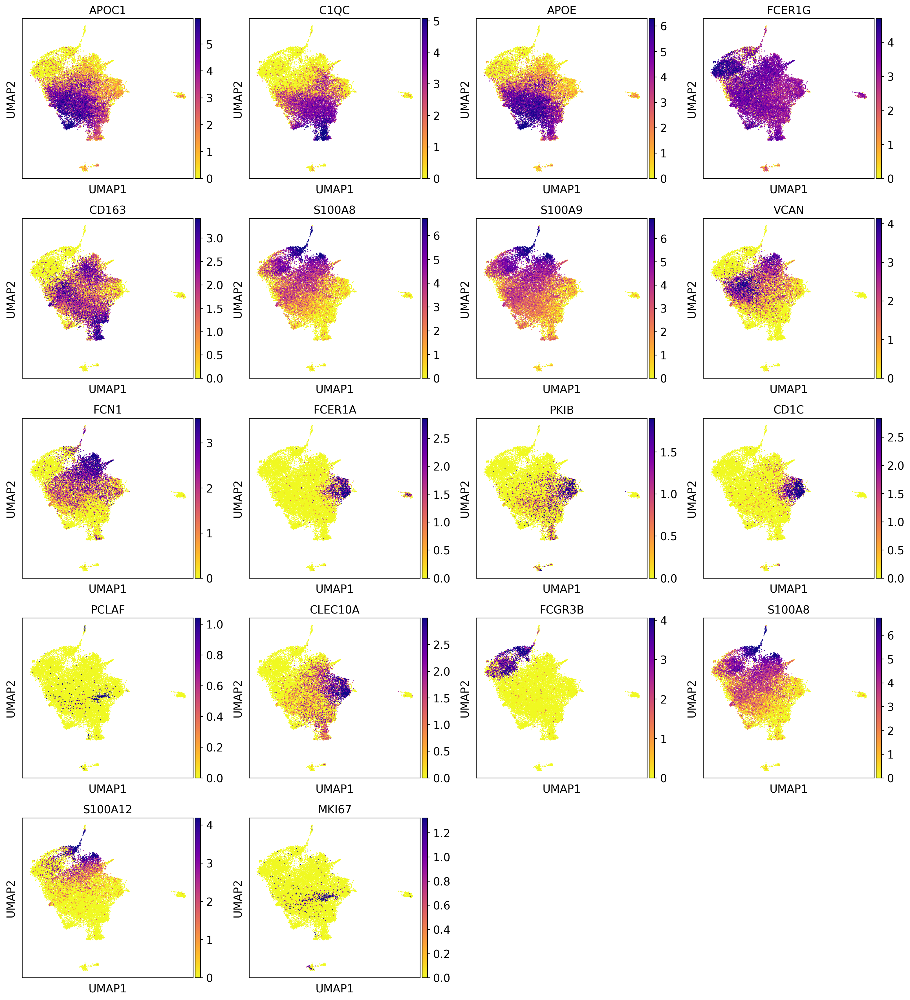

In [23]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_myeloid_general.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

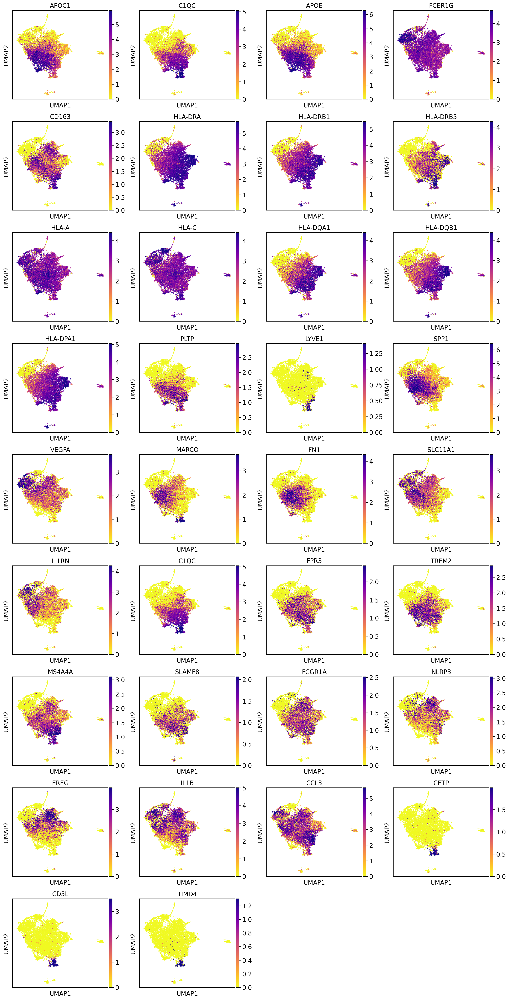

In [24]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_macrophage.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="macrophage_markers.pdf",
    show=True,
)

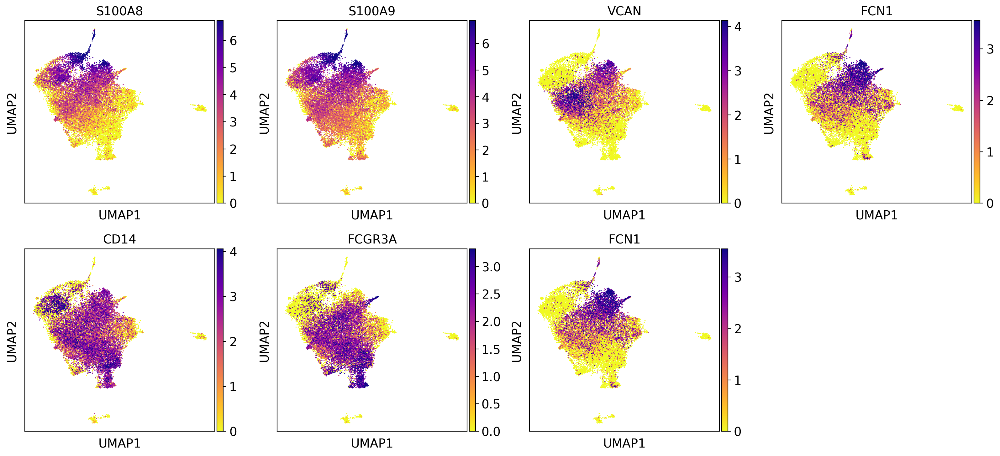

In [25]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_monocyte.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="monocyte_markers.pdf",
    show=True,
)

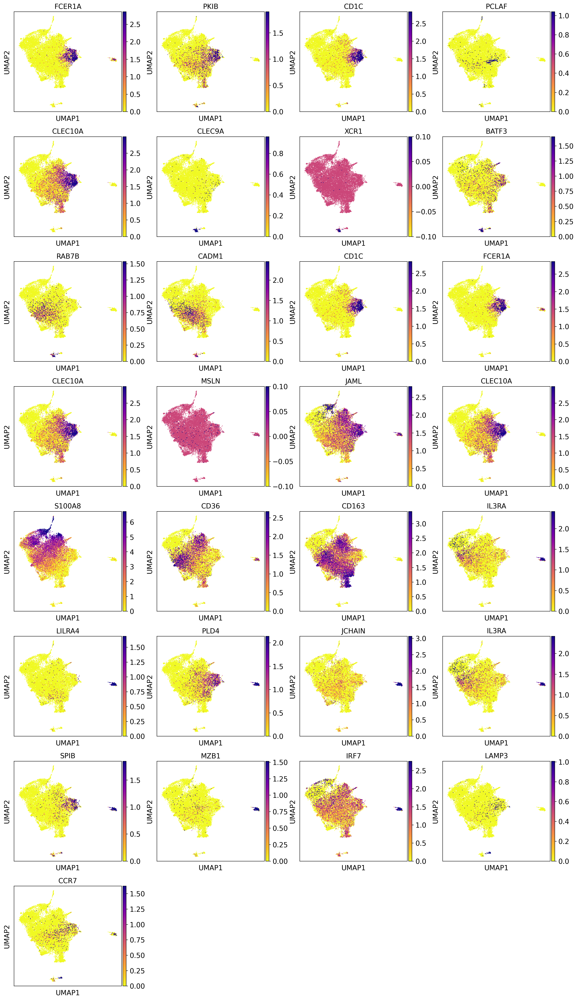

In [26]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(DC_markers.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="monocyte_DC.pdf",
    show=True,
)

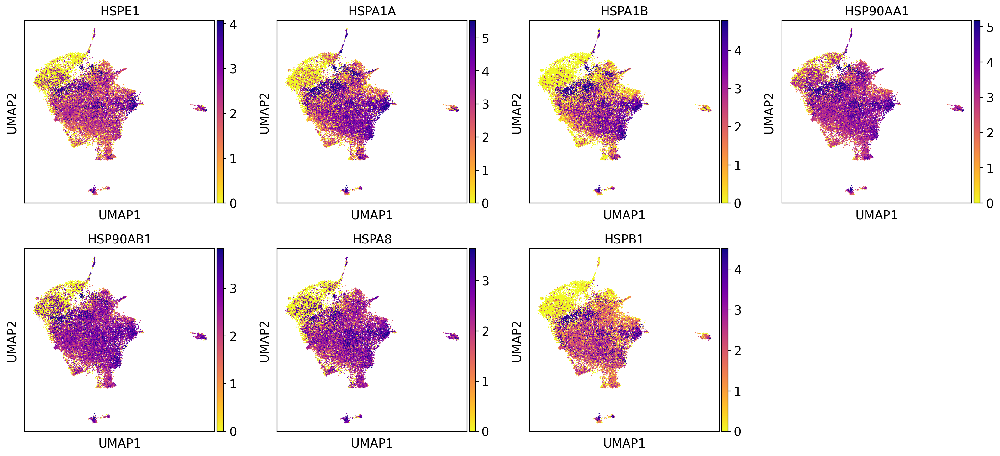

In [27]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="general_HSPmarkers.pdf",
    show=True,
)

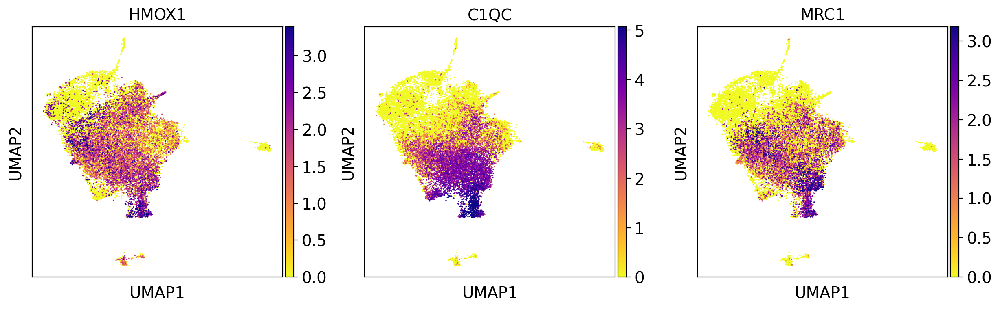

In [28]:
mono_mac = ["HMOX1", "C1QC", "MRC1"]
sc.pl.umap(
    adata,
    color=mono_mac,
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="general_mono_mac.pdf",
    show=True,
)

### Differential expression to get DE genes upregulated per cluster 

In [29]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata.uns["log1p"]["base"] = None

In [30]:
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_

categories: 0, 1, 2, etc.
var_group_labels: Macrophage, Monocyte, DC, etc.


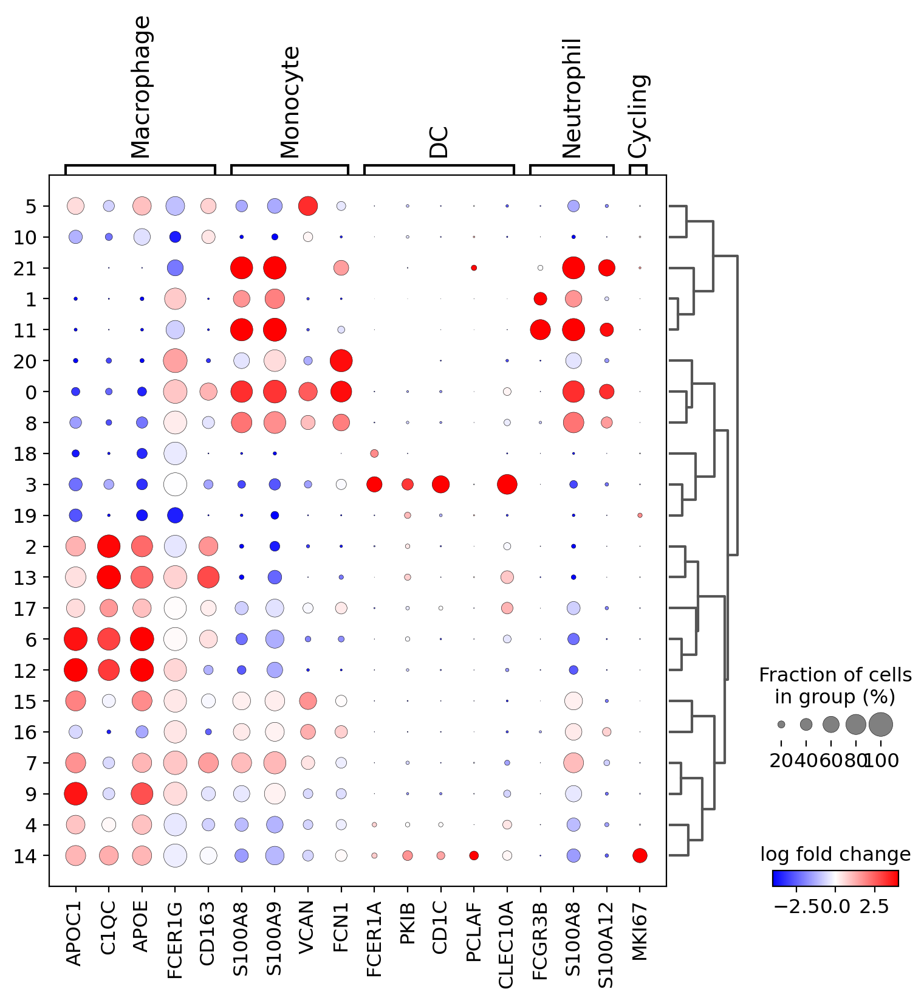

In [31]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers_myeloid_general,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="general_dotplot.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: Macrophage, MHCII, PLTP LYVE1, etc.


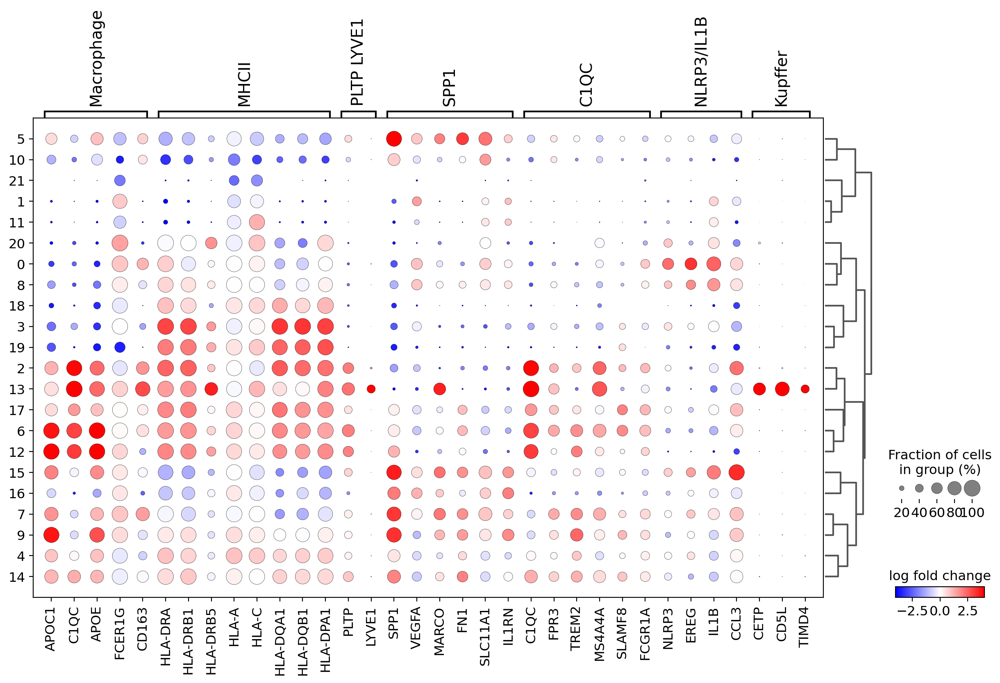

In [32]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers_macrophage,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="macrophage_dotplot.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: Monocyte, CD14, CD16, etc.


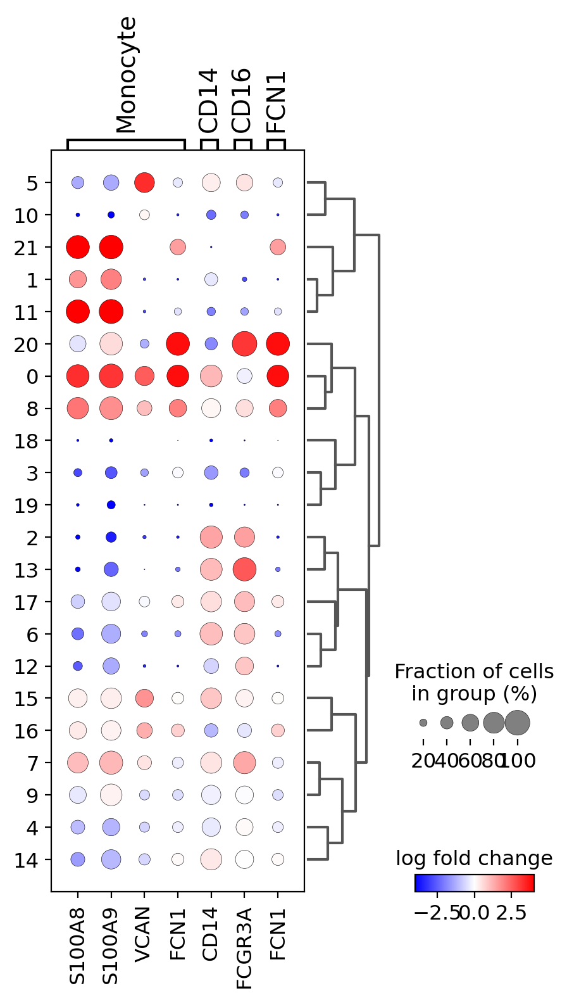

In [33]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers_monocyte,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="monocyte_dotplot.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: DC, cDC1, cDC2, etc.


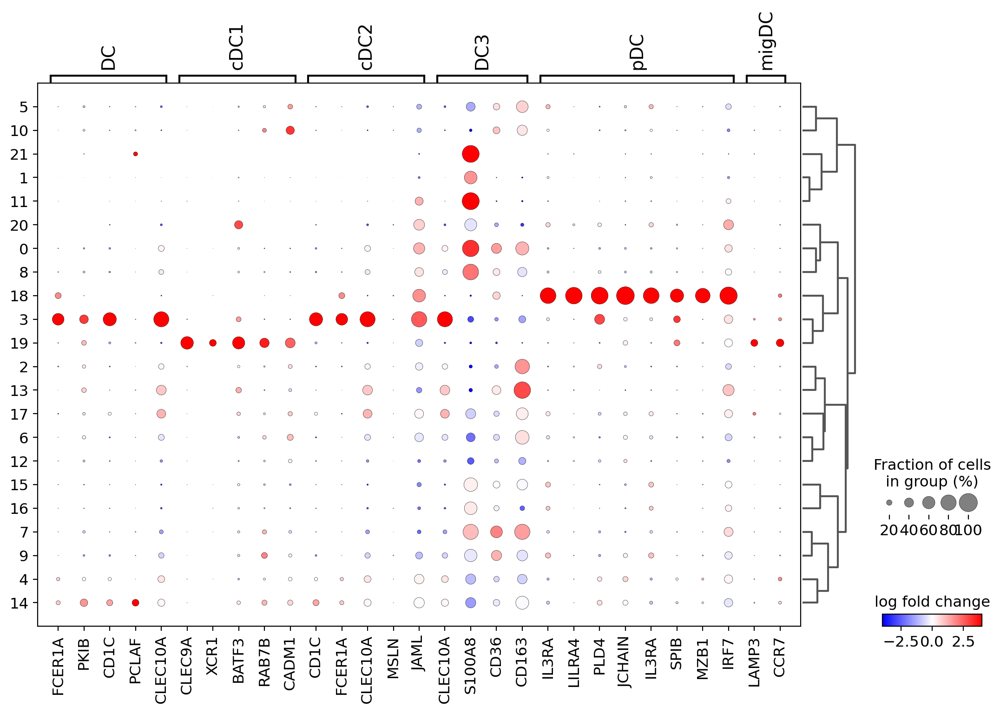

In [34]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=DC_markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="DC_dotplot.pdf",
    show=True,
)

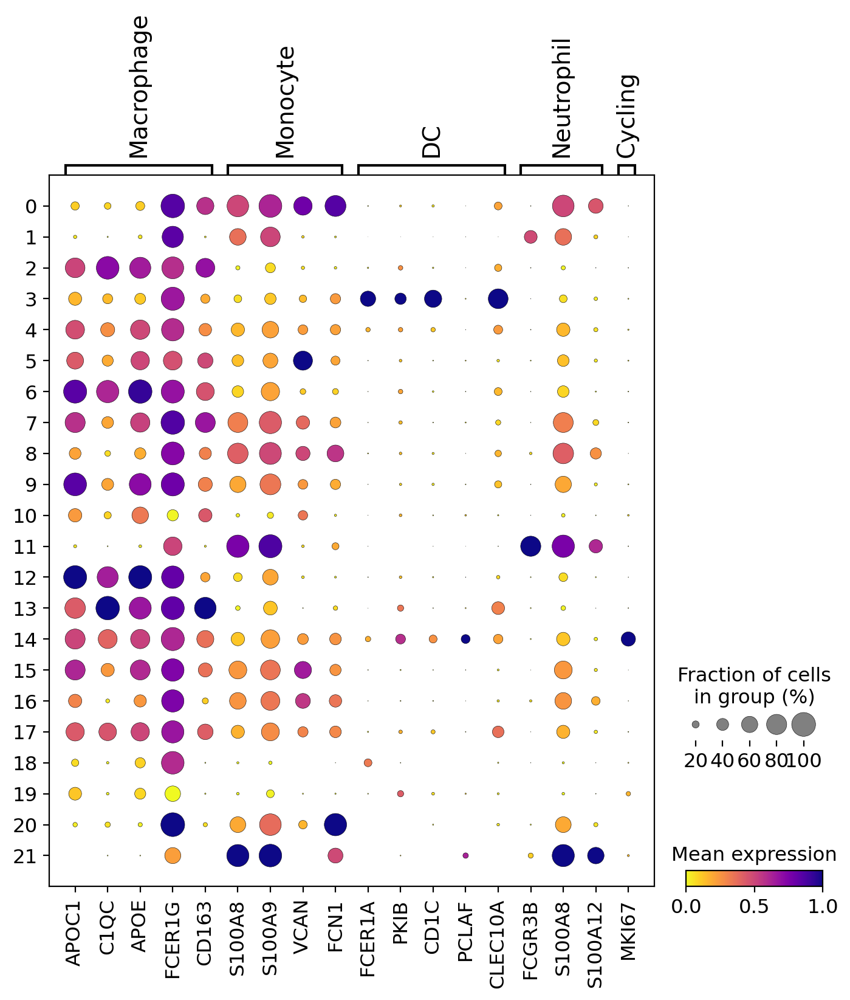

In [35]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_myeloid_general,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general.pdf",
    show=True,
)

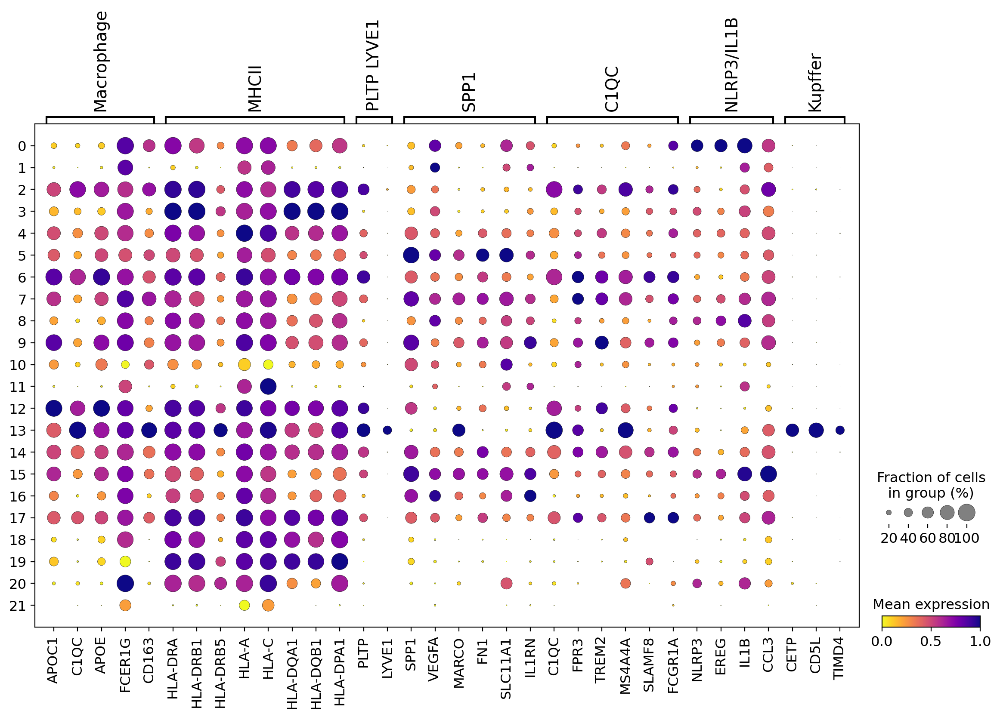

In [36]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_macrophage,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_mac.pdf",
    show=True,
)

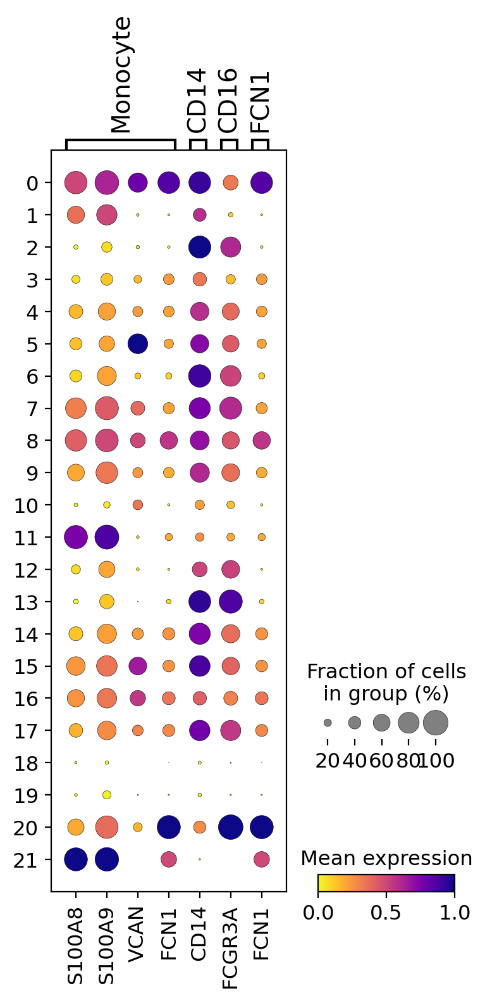

In [37]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_monocyte,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_mono.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: shock protein, immediate early genes


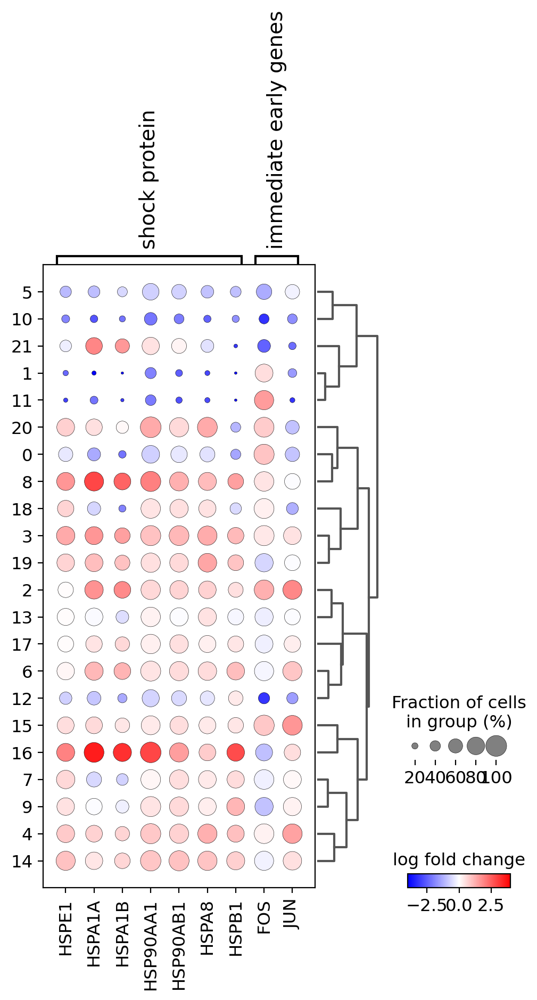

In [38]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=dissocation_markers_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="HSP_dotplot.pdf",
    show=True,
)

In [39]:
pval_thresh = 0.05
log2fc_thresh = 1
cluster_de_genes = dict()
for cluster in sorted(set(adata.obs["leiden_scVI"])):
    cluster_de_genes[cluster] = sc.get.rank_genes_groups_df(
        adata,
        group=cluster,
        key="rank_genes_wilcoxon",
        pval_cutoff=pval_thresh,
        log2fc_min=log2fc_thresh,
        log2fc_max=None,
    ).sort_values("logfoldchanges", ascending=False)

# write to excel file DE genes per cluster
# Create a Pandas Excel writer using XlsxWriter as the engine.
path2save = DIR2SAVE.joinpath(
    "Myeloid_pval{}_log2fc{}.xlsx".format(pval_thresh, log2fc_thresh)
)

with pd.ExcelWriter(path2save) as writer:
    for cluster in list(cluster_de_genes.keys()):

        # get celltype of cluster
        # celltype = np.unique(adata[adata.obs['leiden']==cluster,:].obs['cell identity'])[0]

        cluster_de_genes[cluster].to_excel(
            writer, sheet_name="cluster{}".format(cluster)
        )

In [40]:
# save intermediate result
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Myeloid_clustering.h5ad"
    )
)

In [114]:
adata[adata.obs["leiden_scVI"] == "15"].obs["cell_source"].value_counts()

Wu-Cells      256
Che-Cells     248
BCI-Nuclei      3
Name: cell_source, dtype: int64

In [115]:
adata[adata.obs["leiden_scVI"] == "15"].obs["Cell_subtype"].value_counts()

SPP1+ Activated Macrophage    244
Mono-like FCN1                 89
HSP                            64
TAM SPP1                       47
TAM IL1B/NLRP3                 21
TAM C1QC                       16
MRC1+ M2-like Macrophage        5
Mac PLTP                        5
Myeloid/T doublet               4
Neutrophils                     4
No annotation                   3
CLEC10A+ cDC2                   1
EGR1+ Activated B cells         1
S100A8+ Monocytes               1
TAM MKI67                       1
cDC2                            1
Name: Cell_subtype, dtype: int64

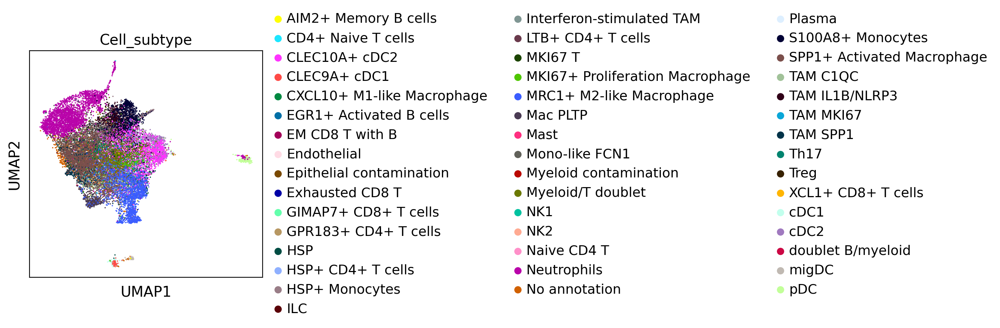

In [107]:
sc.pl.umap(adata, color="Cell_subtype")

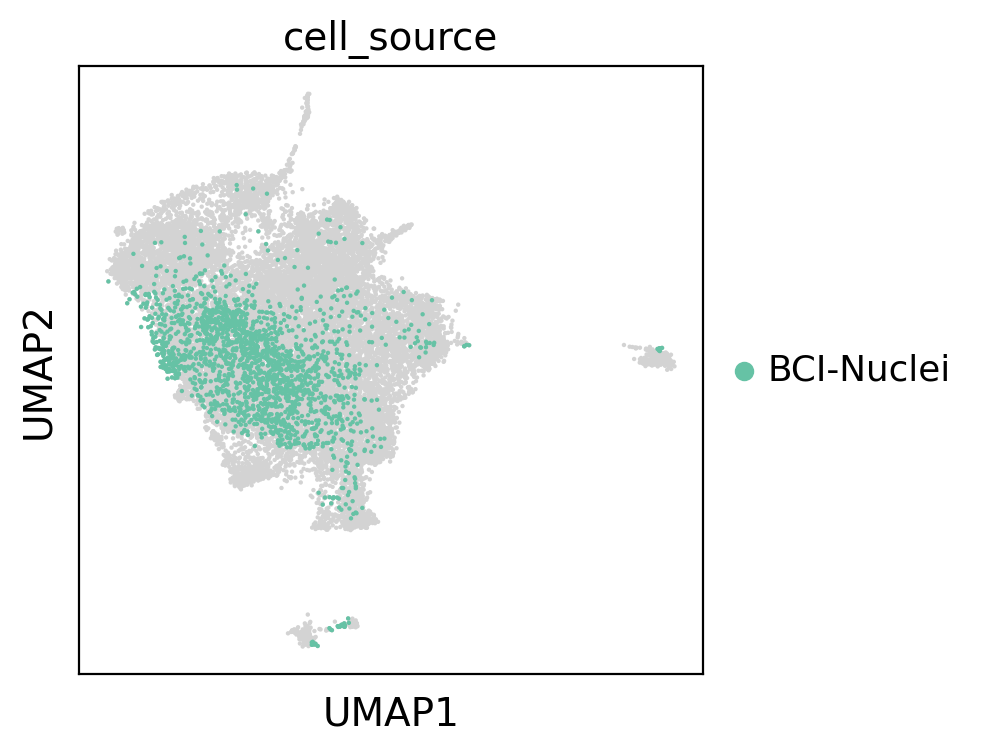

In [108]:
ax = sc.pl.umap(adata, size=10, show=False)
sc.pl.umap(
    adata[adata.obs["cell_source"] == "BCI-Nuclei"], size=10, color="cell_source", ax=ax
)

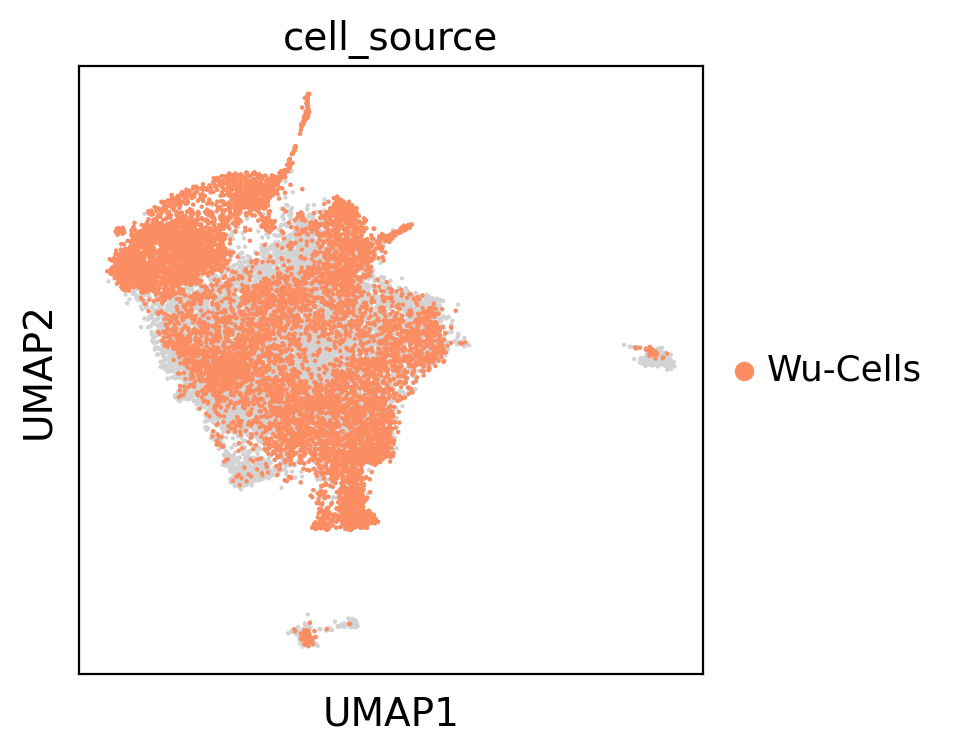

In [109]:
ax = sc.pl.umap(adata, size=10, show=False)
sc.pl.umap(
    adata[adata.obs["cell_source"] == "Wu-Cells"], size=10, color="cell_source", ax=ax
)

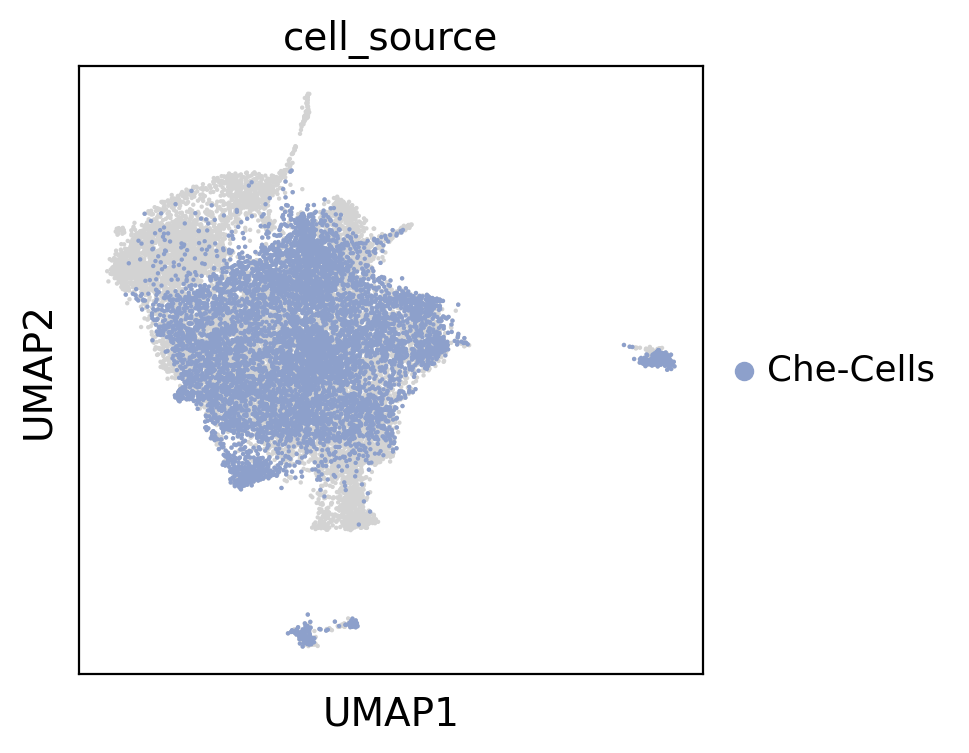

In [110]:
ax = sc.pl.umap(adata, size=10, show=False)
sc.pl.umap(
    adata[adata.obs["cell_source"] == "Che-Cells"], size=10, color="cell_source", ax=ax
)

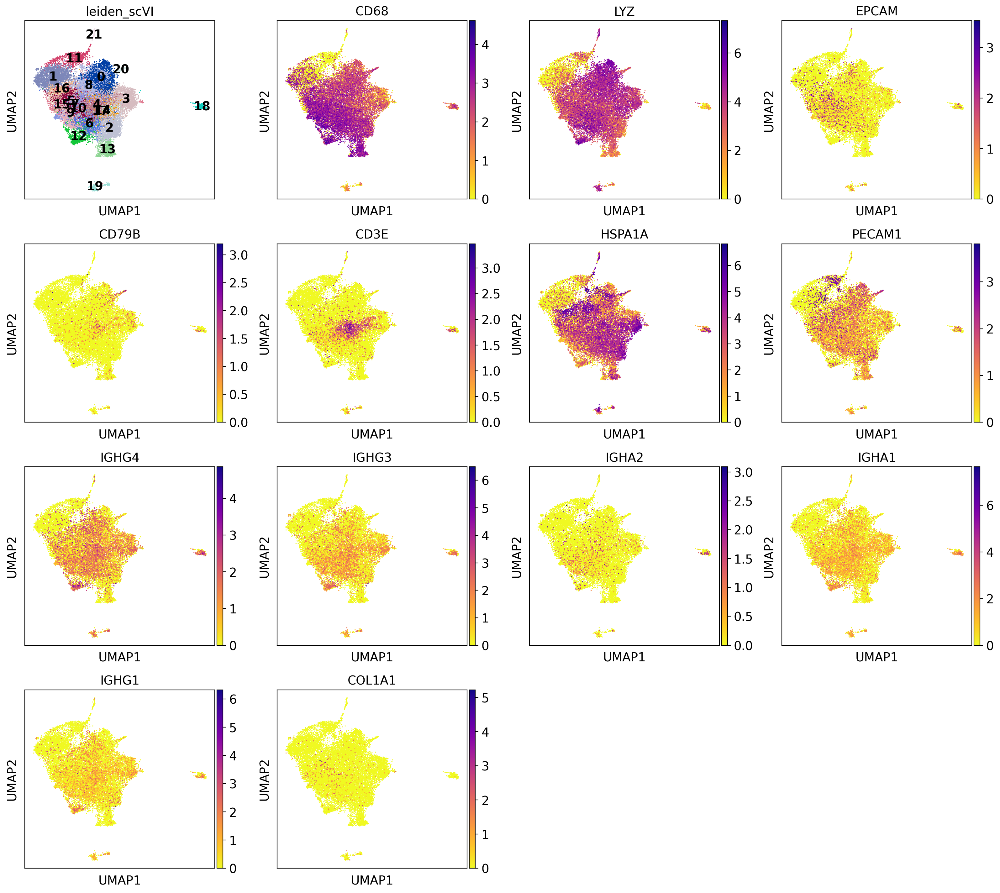

In [113]:
sc.pl.umap(
    adata,
    color=[
        "leiden_scVI",
        "CD68",
        "LYZ",
        "EPCAM",
        "CD79B",
        "CD3E",
        "HSPA1A",
        "PECAM1",
        "IGHG4",
        "IGHG3",
        "IGHA2",
        "IGHA1",
        "IGHG1",
        "COL1A1",
    ],
    legend_loc="on data",
    color_map="plasma_r",
    use_raw=True,
    save="markers_contamination.pdf",
)  # RdPu